# Libraries and data

In [1]:
import numpy as np
import pandas as pd
import datetime as dt
from decimal import *

import os
import matplotlib.pyplot as plt

# Plotly requirements
import plotly.offline as py
py.init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.tools as tls
import plotly.figure_factory as ff

%matplotlib inline
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

In [2]:
orders_path = '../orders_additional_cleaned.csv'

df_orders = pd.read_csv(orders_path,
                        dtype=
                        {'Customer number': object,
                         'Gender': 'category',
                         'PoR': object,
                         'Order number': object,
                         'Product number': object,
                         'Sub category': 'category',
                         'Category': 'category',
                         'Count': np.int16,
                         'Price': np.float64,
                         'EDT': np.int16,
                         'ADT': np.int16,
                         'RoR': object,
                         'Rating': np.int8})

df_orders["Order date"] = pd.to_datetime(df_orders["Order date"], format="%d-%m-%Y")
df_orders["DoB"] = pd.to_datetime(df_orders["DoB"], format="%d-%m-%Y")

# Feature engineering

## "Returned"
    -> binary value
    -> is the product retured or not

In [3]:
df_orders.loc[df_orders['RoR'].isnull(), 'Returned'] = 0
df_orders.loc[df_orders['RoR'].notnull(), 'Returned'] = 1
df_orders = df_orders.drop('RoR', axis=1)

## "Price per product"
    -> what is the price of the product ordered

In [4]:
df_orders['Price per Product'] = df_orders['Price'] / df_orders['Count']

## "Man" / "Woman"
    -> boolean values
    -> is the gender man or woman
    -> the method is called One-Hot-Encoding. It is done instead of changing the genders to 0 and 1 in the original column, so the models in the future can diferentiate them like categories, not numbers
    -> as there are statistically unimportant number of missing gender values, we will make both columns 'Man' and 'Woman' = 0

In [5]:
df_orders.loc[df_orders['Gender'] == "Man", 'Man'] = 1
df_orders.loc[df_orders['Gender'] == "Woman", 'Man'] = 0
df_orders.loc[df_orders['Gender'] == "Man", 'Woman'] = 0
df_orders.loc[df_orders['Gender'] == "Woman", 'Woman'] = 1

In [6]:
df_orders['Man'].replace(np.nan, 0, inplace=True)
df_orders['Woman'].replace(np.nan, 0, inplace=True)

## "Age" 
    -> based on the date of birth

In [7]:
today = dt.datetime.today()

df_orders["DoB"] = pd.to_datetime(df_orders["DoB"], format="%d-%m-%Y")
df_orders["Age"] = today.year - df_orders["DoB"].dt.year - ((today.month <= df_orders["DoB"].dt.month)
                                                            & (today.day <= df_orders["DoB"].dt.day))

## "Order month" and "Order year"
    -> separate the month and the year of an order for easier analysis

In [8]:
df_orders["Order date"] = pd.to_datetime(df_orders["Order date"], format="%d-%m-%Y")
df_orders["Order month"] = df_orders["Order date"].dt.month
df_orders["Order year"] = df_orders["Order date"].dt.year

## "DeltaT"
    -> number representation of the days
    -> the 0 day is 01-01-2013 and each next day is +1

In [9]:
first_order = pd.to_datetime("01-01-2013", format="%d-%m-%Y")
df_orders["DeltaT"] = (df_orders["Order date"] - first_order).dt.days

# Current information about the dataset

In [10]:
df_orders.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 664808 entries, 0 to 664807
Data columns (total 22 columns):
Customer number      664808 non-null object
DoB                  664808 non-null datetime64[ns]
Gender               664808 non-null category
PoR                  664808 non-null object
Order number         664808 non-null object
Order date           664808 non-null datetime64[ns]
Product number       664808 non-null object
Sub category         664808 non-null category
Category             664808 non-null category
Count                664808 non-null int16
Price                664808 non-null float64
EDT                  664808 non-null int16
ADT                  664808 non-null int16
Rating               664808 non-null int8
Returned             664808 non-null float64
Price per Product    664808 non-null float64
Man                  664808 non-null float64
Woman                664808 non-null float64
Age                  664808 non-null int64
Order month          664808 non-

# Exploratory Data Analysis (EDA)

## Gender distribution

In [11]:
unique_gender = df_orders[['Customer number', 'Man', 'Woman']]
unique_gender = unique_gender.drop_duplicates('Customer number')

male = unique_gender[unique_gender['Man'] == 1]
female = unique_gender[unique_gender['Woman'] == 1]

In [12]:
labels = 'Male', 'Female'
values = [len(male), len(female)]

#------------COUNT-----------------------
trace = go.Bar(x = (len(male), len(female)), y = ['Male', 'Female'], orientation = 'h', opacity = 0.8, marker=dict(
        color=['lightskyblue', 'lightpink'],
        line=dict(color='#000000',width=1.5)))

layout = dict(title =  'Gender distribution', autosize=False, width=600, height=400)

                    
fig = dict(data = [trace], layout=layout)
py.iplot(fig)

#------------PERCENTAGE-------------------
trace = go.Pie(labels = ['Male', 'Female'], values = values, 
               textfont=dict(size=15), opacity = 0.8,
               marker=dict(colors=['lightskyblue','lightpink'], 
                           line=dict(color='#000000', width=1.5)))


layout = dict(title =  'Gender distribution', autosize=False, width=500, height=500)
           
fig = dict(data = [trace], layout=layout)
py.iplot(fig)

## Age distribution

In [13]:
customers_age = df_orders[['Customer number', 'Age']]

customers_age = customers_age.drop_duplicates('Customer number')

In [14]:
x = customers_age['Age']
hist_data = [x]
group_labels = ['Ages']

fig = ff.create_distplot(hist_data, group_labels, bin_size=.5, colors=['lightskyblue'])
fig['layout'].update(title='Distribution of ages')
py.iplot(fig, filename='dist-ages')

## Categories and subcategories

In [15]:
df_ordered_categories = df_orders.groupby(['Category', 'Sub category'])
print(df_ordered_categories[['Category', 'Sub category']].nunique().to_string())

                                                              Category  Sub category
Category          Sub category                                                      
Control           Grout brushes                                      1             1
                  Insects and vermin                                 1             1
                  Insects and vermin (2-pack)                        1             1
                  Weed brush                                         1             1
                  Weed brush (2-pack)                                1             1
                  Weed burner                                        1             1
                  Weed burner (2-pack)                               1             1
                  \                                                  1             1
                  Grout brushes (2-pack)                             1             1
Garden decoration Garden gnomes                                  

## Money earned per category

In [16]:
categories = df_orders.groupby(['Category'])['Category'].apply(np.unique)

In [17]:
money_per_category = df_orders.groupby(['Category'])['Price'].sum()
pd.options.display.float_format = '€{:,.2f}'.format
money_per_category

Category
Control               €8,842,284.57
Garden decoration    €23,584,098.97
Garden furniture    €152,726,203.84
Garden hand tools     €1,205,762.32
Garden heating       €10,666,121.23
Garden reamers        €3,151,244.58
Gardening tools       €7,716,267.65
Lounge furniture     €37,560,152.84
Other furniture       €8,138,896.75
Pruning               €6,157,488.62
Sun protection       €37,030,069.37
Watering             €16,495,131.27
Name: Price, dtype: float64

## Distribution of orders per customer

In [18]:
df_orders = df_orders.sort_values(['Customer number', 'Order date'])

orders_per_customer = df_orders[['Customer number', 'Order number']]
orders_per_customer = orders_per_customer.groupby('Customer number')['Order number'].count().reset_index()
orders_per_customer.rename(columns = {'Order number' : 'Number of orders'}, inplace=True)

In [19]:
x = orders_per_customer['Number of orders']
hist_data = [x]
group_labels = ['Total number of orders']

fig = ff.create_distplot(hist_data, group_labels, bin_size=.5, colors=['lightskyblue'])
fig['layout'].update(title='Distribution of orders per customer')
py.iplot(fig, filename='dist-orders-perCustomer')

## Replacing all -1 values with NaN in 'Rating'

In [20]:
df_orders['Rating'].replace(-1, np.nan, inplace=True)

## Average rating per customer

In [21]:
pd.reset_option('^display.', silent=True)
rating_per_customer_avg = df_orders[['Customer number', 'Rating']]
rating_per_customer_avg.head()

,Customer number,Rating
582635,1004533,2.0
583174,1004533,2.0
576205,1004533,NaN
579645,1004533,NaN
580515,1004533,NaN


In [22]:
rating_per_customer_avg = rating_per_customer_avg.groupby('Customer number')['Rating'].mean().reset_index()

##### Give all people that haven't given raiting an average raiting value of -1

In [23]:
rating_per_customer_avg['Rating'].replace(np.nan, -1, inplace=True)
rating_per_customer_avg.rename(columns = {'Rating' : 'Average rating'}, inplace=True)

## Estimated date of arrival / actual date of arrival

In [24]:
df_average_edt_divided_by_adt_per_customer = df_orders[['Customer number', 'EDT', 'ADT', 'Age']]

In [25]:
df_average_edt_divided_by_adt_per_customer = df_average_edt_divided_by_adt_per_customer.groupby('Customer number')['EDT', 'ADT'].mean().reset_index()

In [26]:
df_average_edt_divided_by_adt_per_customer['EDT_divided_ADT'] = df_average_edt_divided_by_adt_per_customer['EDT'] / df_average_edt_divided_by_adt_per_customer['ADT']

In [27]:
df_average_edt_divided_by_adt_per_customer.head()

,Customer number,EDT,ADT,EDT_divided_ADT
0,1004533,2.636364,5.454545,0.483333
1,1004534,5.833333,10.500000,0.555556
2,1004535,3.153846,6.538462,0.482353
3,1004536,3.500000,6.625000,0.528302
4,1004537,4.333333,7.466667,0.580357


## Percent returned items

In [28]:
returns_per_customer = df_orders[['Customer number', 'Returned']]
total_returns = returns_per_customer.groupby('Customer number')['Returned'].count()
actual_returns = returns_per_customer[returns_per_customer['Returned'] == 1].groupby('Customer number')['Returned'].count()

returns_per_customer = returns_per_customer.drop_duplicates('Customer number')
returns_per_customer = returns_per_customer.drop('Returned', axis=1)

percentage_returned = actual_returns.divide(total_returns, fill_value=0).to_frame()
returns_per_customer = pd.merge(returns_per_customer, percentage_returned, how='left', on='Customer number')

# Churn analysis

## Get dates of orders per customer

In [29]:
dates_per_customer = df_orders[['Customer number', 'Order number', 'Order date']]
dates_per_customer = dates_per_customer.drop_duplicates('Order number')
dates_per_customer = dates_per_customer.drop('Order number', axis=1)

In [30]:
customer_dates = dates_per_customer.groupby('Customer number')['Order date'].apply(lambda x: x.tolist())
customer_dates_dict = customer_dates.to_dict()
customer_dates = customer_dates.reset_index()

## Calculate orders' date difference to determine churn
    -> the algorithm calculates the days difference between two consecutive orders and gets the mean of all differences + the standart deviation of all differences
    -> based on that we later determine if the customer has churned, using the date of his/hers last order

In [31]:
last_order_date = pd.Timestamp(df_orders['Order date'].max())

In [32]:
def calculate_mean(dates):
    days = np.empty(len(dates) - 1)
    for i, date in enumerate(dates):
        if i < len(dates) - 1:
            days[i] = ((dates[i + 1] - dates[i]).days)

    return round(days.mean()+days.std())

In [33]:
churn_array = np.empty(len(customer_dates_dict.items()))
meanstd_time_between_orders_array = np.empty(len(customer_dates_dict.items()))

for i, (key, value) in enumerate(customer_dates_dict.items()):
    meanstd_time_between_orders = calculate_mean(value)
    if (last_order_date - customer_dates_dict[key][-1]).days > meanstd_time_between_orders:
        churn_array[i] = 1
    else:
        churn_array[i] = 0
    meanstd_time_between_orders_array[i] = meanstd_time_between_orders

## Drop unessecary featutures and get unique customer numbers

In [34]:
df_orders = df_orders.drop(
    ['Order number', 'Order date', 'EDT', 'ADT', 'Rating', 'Returned'],
    axis=1).drop_duplicates().reset_index().drop('index', axis=1)

In [35]:
unique_ages_gender = df_orders[['Customer number', 'Age', 'Man', 'Woman']].drop_duplicates().reset_index().drop('index', axis=1)

## Create a dateset for customer churn analysis

In [36]:
customer_dates['T_between_orders'] = meanstd_time_between_orders_array
customer_dates['Number of orders'] = orders_per_customer['Number of orders']
customer_dates['Average rating'] = rating_per_customer_avg['Average rating']
customer_dates['Percentage returns'] = returns_per_customer['Returned']
customer_dates['EDT'] = df_average_edt_divided_by_adt_per_customer['EDT']
customer_dates['ADT'] = df_average_edt_divided_by_adt_per_customer['ADT']
customer_dates['EDT_divided_ADT'] = df_average_edt_divided_by_adt_per_customer['EDT_divided_ADT']
customer_dates['Man'] = unique_ages_gender['Man']
customer_dates['Woman'] = unique_ages_gender['Woman']
customer_dates['Age'] = unique_ages_gender['Age']
customer_dates['Churn'] = churn_array
customer_dates.drop('Order date', axis=1, inplace=True)
customer_dates.dropna(inplace=True)

customer_dates.to_csv('../additional_orders_churn.csv', index=False)

# Plots

In [37]:
x = customer_dates[customer_dates['Churn'] == 1]['Churn'].count()
y = customer_dates[customer_dates['Churn'] == 0]['Churn'].count()

labels = ['Churned', 'Not churned']
values = [x, y]

#------------COUNT-----------------------
trace = go.Bar(x = values, y = labels, orientation = 'h', opacity = 0.8, marker=dict(
        color=['lightskyblue', 'lightpink'],
        line=dict(color='#000000',width=1.5)))

layout = dict(title =  'Churn distribution', autosize=False, width=600, height=400)

                    
fig = dict(data = [trace], layout=layout)
py.iplot(fig)

#------------PERCENTAGE-------------------
trace = go.Pie(labels = labels, values = values, 
               textfont=dict(size=15), opacity = 0.8,
               marker=dict(colors=['lightskyblue','lightpink'], 
                           line=dict(color='#000000', width=1.5)))


layout = dict(title =  'Churn distribution', autosize=False, width=500, height=500)
           
fig = dict(data = [trace], layout=layout)
py.iplot(fig)

In [38]:
# data to plot
mean_edt = customer_dates['EDT'].mean()
mean_adt = customer_dates['ADT'].mean()
values = [mean_edt, mean_adt]
lables = ['Estimated date', 'Actual date']

trace1 = go.Bar(
    x=['EDT'],
    y=[mean_edt],
    name='Estimated date of arrival',
    marker=dict(
        color=['lightpink'],
        line=dict(color='#000000',width=1.5))
)
trace2 = go.Bar(
    x=['ADT'],
    y=[mean_adt],
    name='Actual date of arrival',
    marker=dict(
        color=['lightskyblue'],
        line=dict(color='#000000',width=1.5))
)

data = [trace1, trace2]
layout = go.Layout(
    barmode='group',
    title='Arrival Date Comparison - mean values'
)

fig = go.Figure(data=data, layout=layout)
py.iplot(fig, filename='arrival-date-comparison')

In [39]:
x = customer_dates['T_between_orders'] 
hist_data = [x]
group_labels = ['Time between orders']

fig = ff.create_distplot(hist_data, group_labels, bin_size=1, colors=['lightskyblue'])
py.iplot(fig, filename='time-between-orders-hist')

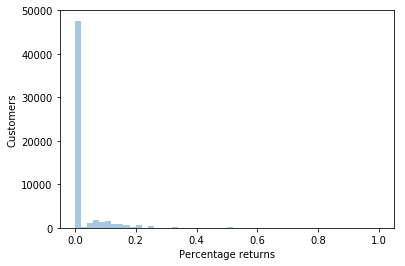

In [42]:
ax = sns.distplot(customer_dates['Percentage returns'], kde=False)
ax.set(ylabel='Customers')
plt.show()

In [45]:
x = customer_dates['Average rating']
hist_data = [x]
group_labels = ['Average raitings']

fig = ff.create_distplot(hist_data, group_labels, bin_size=0.2, colors=['lightskyblue'])
py.iplot(fig, filename='average-rairings')

In [51]:
#correlation
correlation = customer_dates.corr()
#tick labels
matrix_cols = correlation.columns.tolist()
#convert to array
corr_array  = np.array(correlation)

#Plotting
trace = go.Heatmap(z = corr_array,
                   x = matrix_cols,
                   y = matrix_cols,
                   colorscale='Viridis',
                   colorbar   = dict() ,
                  )
layout = go.Layout(dict(title = 'Correlation Matrix',
                        autosize = False,
                        height  = 500,
                        width   = 600))
fig = go.Figure(data = [trace],layout = layout)
py.iplot(fig)

# Distribution of variables in customer churn

In [54]:
customer_dates.drop('EDT_divided_ADT', inplace = True, axis = 1)
churn     = customer_dates[customer_dates["Churn"] == 1]
not_churn = customer_dates[customer_dates["Churn"] == 0]

targetCol = ["Churn"]
catCols = customer_dates.nunique()[customer_dates.nunique() < 6].keys().tolist()
catCols = [x for x in catCols if x not in targetCol]

numerics = ['float64', 'int64']
numeric_df = customer_dates.select_dtypes(include=numerics)
objects_df = customer_dates.select_dtypes(exclude=numerics)

keyCol = ['Customer number']
numCols = [x for x in customer_dates.columns if x not in catCols + keyCol + targetCol]

In [56]:
from matplotlib.ticker import PercentFormatter

def histChart(column):    
    values_churn = churn[column]
    legend = ['Churn', 'Non churn']
    values_nonchurn = not_churn[column]
    
    plt.hist([values_churn, values_nonchurn], color=['orange', 'blue'], bins=20, rwidth=0.5, density=1)
    plt.xlabel(column, fontsize=16)
    plt.legend(legend)
    plt.title(column + ' distribution in customer churn', fontsize=16)
    plt.rcParams['figure.figsize'] = (20,7)
    plt.show()

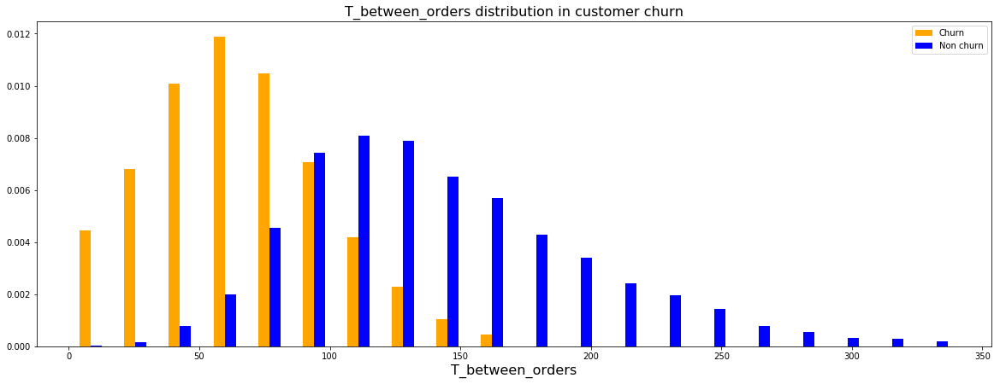

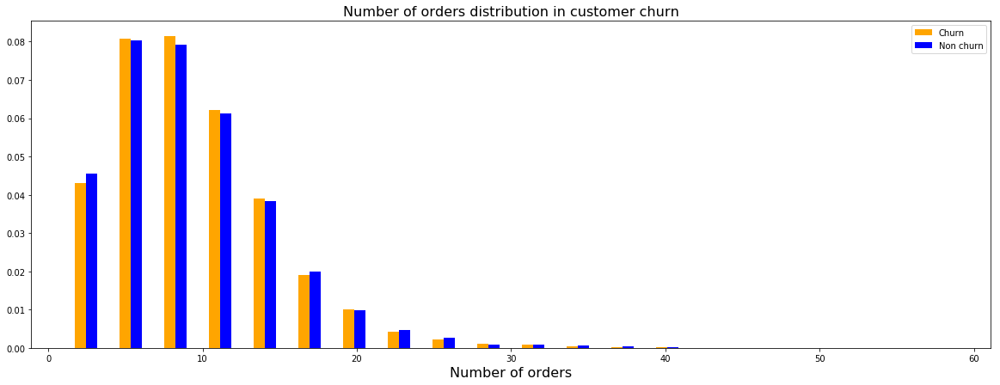

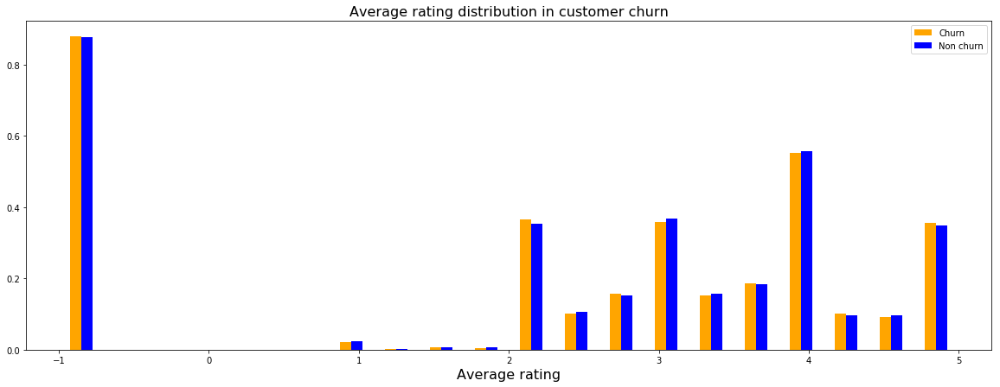

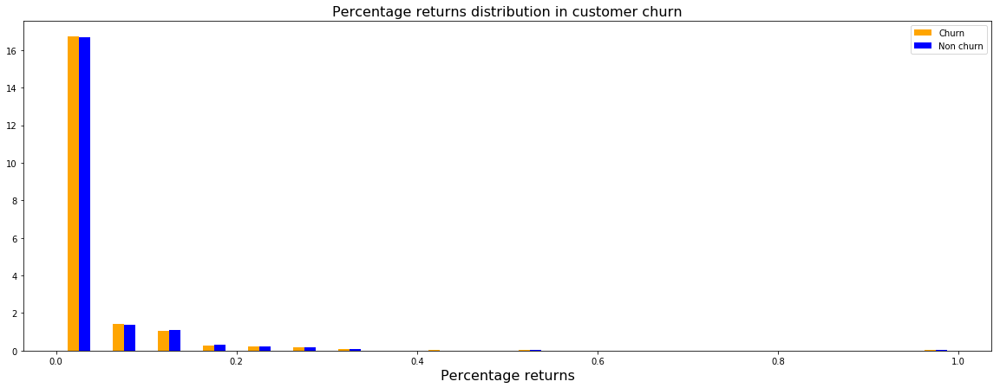

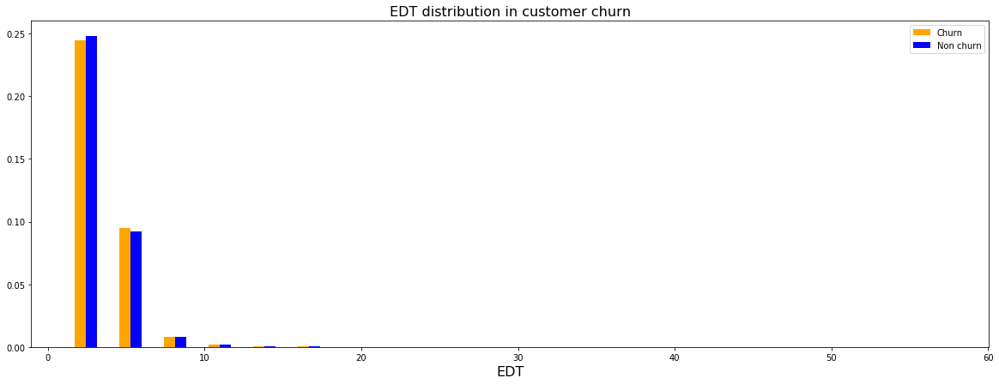

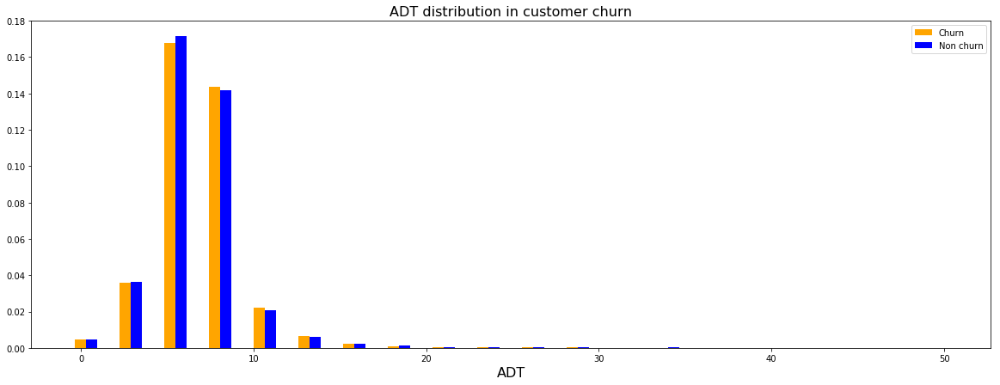

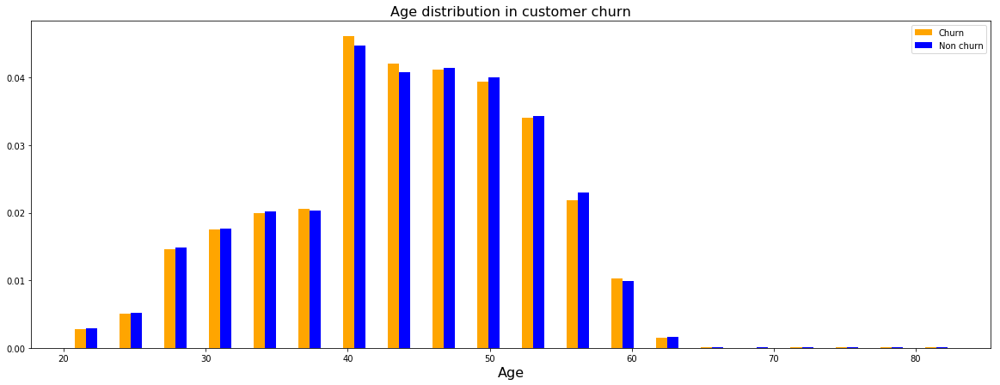

In [58]:
for i in numCols:
    histChart(i)
    print("\n\n")